<a href="https://colab.research.google.com/github/gbibbo/autocue/blob/main/MIR_Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# MIR Final Project #

### AUTOMATIC DETECTION OF SWITCH POINTS IN EDM

Automatically identify switch points that represent end of the intro and beginning of the otro in EDM tracks.

# Install and initialize

Downloading database and installing dependencies

In [10]:
!git clone https://github.com/gbibbo/autocue.git
!pip install msaf

!pip install IPython
!pip install essentia
!pip install scipy==1.2 --upgrade

fatal: destination path 'autocue' already exists and is not an empty directory.
Requirement already up-to-date: scipy==1.2 in /usr/local/lib/python3.7/dist-packages (1.2.0)


Importing libraries

In [11]:
#!pip install statsmodels --upgrade
from __future__ import print_function
import msaf
import librosa
import seaborn as sns
from essentia.standard import *
import IPython.display as ipd
import matplotlib.pyplot as plt
import numpy as np
import ntpath
import bisect

# and IPython.display for audio output
import IPython.display

# Setup nice plots
sns.set(style="dark")
%matplotlib inline

Plotting functions

In [24]:
def name_of_object(arg):
    # check __name__ attribute (functions)
    try:
        return arg.__name__
    except AttributeError:
        pass

    for name, value in globals().items():
        if value is arg and not name.startswith('_'):
            return name

def plot_song_and_boundaries(audio_file, boundaries, inicio, fin, sr):
    # Plots waveform and boundaries with red marks
  if (fin==(-1)):
    audio = EasyLoader(filename=audio_file, sampleRate=sr)()
    fin=audio.size/sr
  else:
    audio = EasyLoader(filename=audio_file, sampleRate=sr, endTime=fin)()
  plt.figure(figsize=(20,1))

  audio_cut=audio[inicio *sr:audio.size]

  j=boundaries*(boundaries<fin)*(boundaries>inicio)
  j = np.ma.masked_equal(j,0)
  plt.plot(np.arange(inicio , audio.size/sr, 1/float(sr)),audio_cut)
  plt.title(name_of_object(boundaries)+' / '+ntpath.basename(audio_file)+' ('+str(inicio)+'s to '+str(int(fin))+'s)')
  for x in j:
    plt.axvline(x, color='r', linewidth = 3)

Filtering boundaries functions

In [22]:
def filter_in_range (center_num,filtering_array,allowed_range):
  # Looks for center_num in filtering_array with
  # a maximum allowed difference
  #
  # center_num: float
  # filtering_array: numpy.array
  # allowed_range: float

  lower_bound=center_num-allowed_range
  upper_bound=center_num+allowed_range

  lower_bound_i = bisect.bisect_left(filtering_array, lower_bound)
  upper_bound_i = bisect.bisect_right(filtering_array, upper_bound, lo=lower_bound_i)
  nums = filtering_array[lower_bound_i:upper_bound_i]
  return nums

def compare_array(array1,array2,allowed_range):
  # Looks for similar elements between two arrays within
  # a permited range of difference between the elements
  #
  # array1: numpy.array
  # array2: numpy.array
  # allowed_range: float

  filtered=[]
  index=0
  for i in range(len(array1)):
    nums = filter_in_range(array1[i],array2,allowed_range)
    for j in range(len(nums)):
      filtered.append(nums[j])
  res = []
  [res.append(x) for x in filtered if x not in res]    
  retorno = np.zeros(len(res))
  for u in range(len(retorno)):
    retorno[u]=res[u]
  return retorno

def post_process (audio_file,boundaries,tolerance):
  # Deletes positions in boundaries and returns
  # two good candidates for the cue points
  # that indicate the fade_in and fade_out
  # 1) First and last positions are removed (if they 
  # are into the first or last 6% of the total time)
  # 2) Positions outside the tolerance range are removed
  # (i.e. if tolerance=0.8, positions outside (0%,40%)
  # and (60%, 100%) are removed.
  # 3) Returns the second and penultimate positons
  #
  # audio_file: string
  # boundaries: numpy.array
  # tolerance: float

  cue_points=np.zeros(2)
  sr=44100
  audio = EasyLoader(filename=audio_file, sampleRate=sr)()
  fin=audio.size/sr
  mitad=fin/2
  tolerancia=mitad*tolerance
  esp=0.06
  temp2_intro=[]
  num_int=0
  num_out=0
  temp2_outro=[]
  temp_zeros_int=np.zeros(len(boundaries))
  temp_zeros_out=np.zeros(len(boundaries))
  temp_intro=boundaries*(boundaries<tolerancia)*(boundaries>0)
  temp_intro= np.ma.masked_equal(temp_intro,0)
  temp_intro=temp_intro*(temp_intro<tolerancia)*(temp_intro>fin*esp)
  temp_intro= np.ma.masked_equal(temp_intro,0)
  for z in temp_intro:
    if (np.isnan(z)==False):
      temp_zeros_int[num_int]=z
      num_int=num_int+1
  if num_int>1:
    cue_points[0]=temp_zeros_int[1]
  else:
    cue_points[0]=temp_zeros_int[0]

  temp_outro=boundaries*(boundaries<fin)*(boundaries>fin-tolerancia)
  temp_outro= np.ma.masked_equal(temp_outro,0)
  temp_outro=temp_outro*(temp_outro<fin*(1-esp))*(temp_outro>fin-tolerancia)
  temp_outro= np.ma.masked_equal(temp_outro,0)
  for z in temp_outro:
    if (np.isnan(z)==False):
      temp_zeros_out[num_out]=z
      num_out=num_out+1
  if num_out>1:
    cue_points[1]=sorted(temp_zeros_out)[-2]
  else:
    cue_points[1]=temp_zeros_out[0]
  return cue_points

# Detect cue points in your song

/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


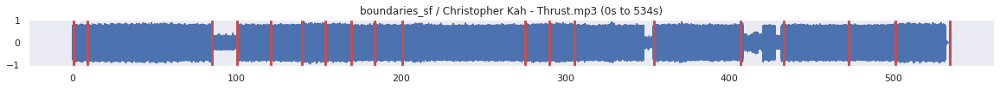

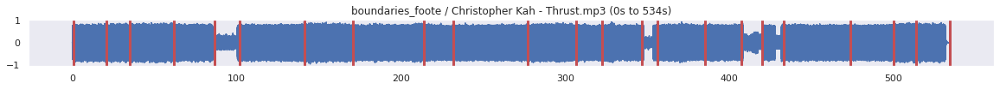

________________________________________________________________________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


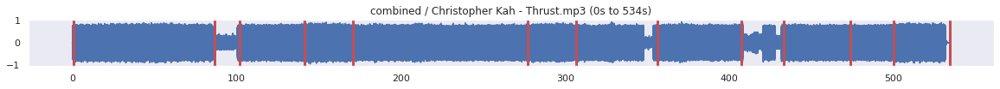

________________________________________________________________________________________________________________________________________


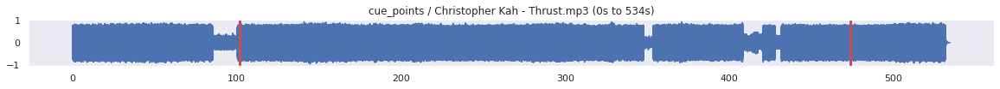

In [23]:
# You can load any EDM song that you want
audio_file = "autocue/audio/Christopher Kah - Thrust.mp3" # <<<<------------------------------

# Compute the boundaries from raw audio using features PCP and boundarie algorithms "SF" and "FOOTE"
boundaries_sf, labels_sf = msaf.process(audio_file, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
boundaries_foote, labels_foote = msaf.process(audio_file, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

# Plot resutlts on top of the waveform
plot_song_and_boundaries ( audio_file , boundaries_sf , 0 , -1 , 1000)
plot_song_and_boundaries ( audio_file , boundaries_foote , 0 , -1 , 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')

# Combine the boundaries manteining only the redundant points
combined = compare_array ( boundaries_sf , boundaries_foote , ran2)
plot_song_and_boundaries ( audio_file , combined , 0 , -1 , 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')

# Filter the points. While the process is quite complicated, it can be said that 
# in some cases it is equivalent to maintaining the third and antepenultimate position.
cue_points = post_process ( audio_file , combined , 0.8)
plot_song_and_boundaries ( audio_file , cue_points , 0 , -1 , 1000)

# Analysis of the system

## Boundaries computation from raw audio
This subsection takes 10 minutes to run. You can avoid it if you just want to analize your audio.

In [14]:
audio_file1 = "autocue/audio/0010X0010 - Escape From Rodeo Drive.mp3"
audio_file2 = "autocue/audio/Belocca - Mother Earth.mp3"
audio_file3 = "autocue/audio/Brendon Moeller - Linear Daybreak.mp3"
audio_file4 = "autocue/audio/Christopher Kah - Thrust.mp3"
audio_file5 = "autocue/audio/Maksim Dark - Energize.mp3"
audio_file6 = "autocue/audio/Noir, Olivier Giacomotto feat. Hendrik Burkhard - Blackrays (Kiko & Citizen Kain Remix).mp3"
audio_file7 = "autocue/audio/Oliver Lieb - Oasis 2020 (Frankyeffe Remix).mp3"
audio_file8 = "autocue/audio/Oliver Lieb - Red Phosphorous (Reduced Mix).mp3"
audio_file9 = "autocue/audio/RDNK - Guess the Number.mp3"

S1B1, S1L1 = msaf.process(audio_file1, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S1B2, S1L2 = msaf.process(audio_file1, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S1B3, S1L3 = msaf.process(audio_file1, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S1B4, S1L4 = msaf.process(audio_file1, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
S1B5, S1L5 = msaf.process(audio_file1, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

S2B1, S2L1 = msaf.process(audio_file2, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S2B2, S2L2 = msaf.process(audio_file2, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S2B3, S2L3 = msaf.process(audio_file2, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S2B4, S2L4 = msaf.process(audio_file2, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
S2B5, S2L5 = msaf.process(audio_file2, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

S3B1, S3L1 = msaf.process(audio_file3, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S3B2, S3L2 = msaf.process(audio_file3, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S3B3, S3L3 = msaf.process(audio_file3, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S3B4, S3L4 = msaf.process(audio_file3, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
S3B5, S3L5 = msaf.process(audio_file3, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

S4B1, S4L1 = msaf.process(audio_file4, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S4B2, S4L2 = msaf.process(audio_file4, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S4B3, S4L3 = msaf.process(audio_file4, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S4B4, S4L4 = msaf.process(audio_file4, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
S4B5, S4L5 = msaf.process(audio_file4, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

S5B1, S5L1 = msaf.process(audio_file5, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S5B2, S5L2 = msaf.process(audio_file5, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S5B3, S5L3 = msaf.process(audio_file5, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S5B4, S5L4 = msaf.process(audio_file5, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
S5B5, S5L5 = msaf.process(audio_file5, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

S6B1, S6L1 = msaf.process(audio_file6, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S6B2, S6L2 = msaf.process(audio_file6, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S6B3, S6L3 = msaf.process(audio_file6, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S6B4, S6L4 = msaf.process(audio_file6, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
S6B5, S6L5 = msaf.process(audio_file6, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

S7B1, S7L1 = msaf.process(audio_file7, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S7B2, S7L2 = msaf.process(audio_file7, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S7B3, S7L3 = msaf.process(audio_file7, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S7B4, S7L4 = msaf.process(audio_file7, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
S7B5, S7L5 = msaf.process(audio_file7, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

S8B1, S8L1 = msaf.process(audio_file8, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S8B2, S8L2 = msaf.process(audio_file8, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S8B3, S8L3 = msaf.process(audio_file8, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S8B4, S8L4 = msaf.process(audio_file8, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
S8B5, S8L5 = msaf.process(audio_file8, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

S9B1, S9L1 = msaf.process(audio_file9, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S9B2, S9L2 = msaf.process(audio_file9, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S9B3, S9L3 = msaf.process(audio_file9, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S9B4, S9L4 = msaf.process(audio_file9, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
S9B5, S9L5 = msaf.process(audio_file9, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32,

The following section can compute more boundaries. We decided to comment it in order to draw them out of this inquiry.

In [17]:
# audio_file1 = "autocue/audio/0010X0010 - Escape From Rodeo Drive.mp3"
# audio_file2 = "autocue/audio/Belocca - Mother Earth.mp3"
# audio_file3 = "autocue/audio/Brendon Moeller - Linear Daybreak.mp3"
# audio_file4 = "autocue/audio/Christopher Kah - Thrust.mp3"
# audio_file5 = "autocue/audio/Maksim Dark - Energize.mp3"
# audio_file6 = "autocue/audio/Noir, Olivier Giacomotto feat. Hendrik Burkhard - Blackrays (Kiko & Citizen Kain Remix).mp3"
# audio_file7 = "autocue/audio/Oliver Lieb - Oasis 2020 (Frankyeffe Remix).mp3"
# audio_file8 = "autocue/audio/Oliver Lieb - Red Phosphorous (Reduced Mix).mp3"
# audio_file9 = "autocue/audio/RDNK - Guess the Number.mp3"

# S1B1, S1L1 = msaf.process(audio_file1, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S1B2, S1L2 = msaf.process(audio_file1, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S1B3, S1L3 = msaf.process(audio_file1, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S1B4, S1L4 = msaf.process(audio_file1, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
# S1B5, S1L5 = msaf.process(audio_file1, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

# S2B1, S2L1 = msaf.process(audio_file2, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S2B2, S2L2 = msaf.process(audio_file2, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S2B3, S2L3 = msaf.process(audio_file2, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S2B4, S2L4 = msaf.process(audio_file2, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
# S2B5, S2L5 = msaf.process(audio_file2, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

# S3B1, S3L1 = msaf.process(audio_file3, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S3B2, S3L2 = msaf.process(audio_file3, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S3B3, S3L3 = msaf.process(audio_file3, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S3B4, S3L4 = msaf.process(audio_file3, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
# S3B5, S3L5 = msaf.process(audio_file3, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

# S4B1, S4L1 = msaf.process(audio_file4, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S4B2, S4L2 = msaf.process(audio_file4, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S4B3, S4L3 = msaf.process(audio_file4, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S4B4, S4L4 = msaf.process(audio_file4, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
# S4B5, S4L5 = msaf.process(audio_file4, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

# S5B1, S5L1 = msaf.process(audio_file5, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S5B2, S5L2 = msaf.process(audio_file5, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S5B3, S5L3 = msaf.process(audio_file5, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S5B4, S5L4 = msaf.process(audio_file5, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
# S5B5, S5L5 = msaf.process(audio_file5, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

# S6B1, S6L1 = msaf.process(audio_file6, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S6B2, S6L2 = msaf.process(audio_file6, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S6B3, S6L3 = msaf.process(audio_file6, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S6B4, S6L4 = msaf.process(audio_file6, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
# S6B5, S6L5 = msaf.process(audio_file6, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

# S7B1, S7L1 = msaf.process(audio_file7, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S7B2, S7L2 = msaf.process(audio_file7, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S7B3, S7L3 = msaf.process(audio_file7, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S7B4, S7L4 = msaf.process(audio_file7, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
# S7B5, S7L5 = msaf.process(audio_file7, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

# S8B1, S8L1 = msaf.process(audio_file8, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S8B2, S8L2 = msaf.process(audio_file8, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S8B3, S8L3 = msaf.process(audio_file8, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S8B4, S8L4 = msaf.process(audio_file8, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
# S8B5, S8L5 = msaf.process(audio_file8, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

# S9B1, S9L1 = msaf.process(audio_file9, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# S9B2, S9L2 = msaf.process(audio_file9, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
# S9B3, S9L3 = msaf.process(audio_file9, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# S9B4, S9L4 = msaf.process(audio_file9, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
# S9B5, S9L5 = msaf.process(audio_file9, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

## Combination of boundaries
In this section you will appreciate the effect of combining the boundaries for each of the files in the dataset. Pay attention to cases where the positions of the boundaries are not exactly the same, but the algorithm still detects and maintains them.

In [26]:
# Some parameters definitions

ran=3.4     # Allowed difference between two similar boundaries positions
ran2=ran*2  # Idem
inicio=0    # Beginning of the plot
fin=-1      # -1 plots all the waveform. Another value narrows down the plot

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


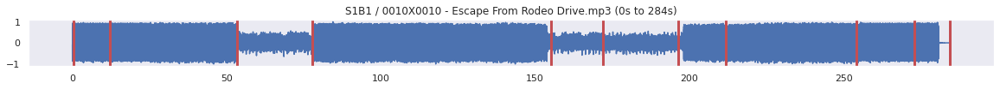

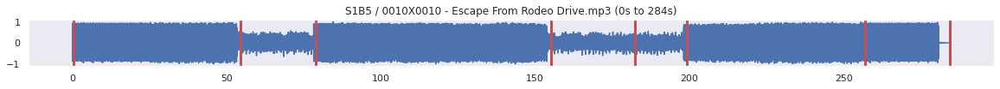

________________________________________________________________________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


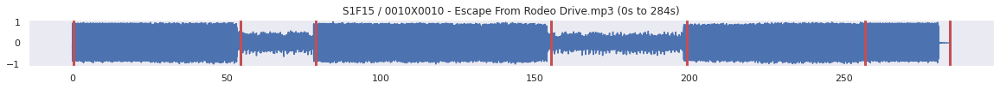

In [27]:
plot_song_and_boundaries(audio_file1, S1B1, inicio, fin, 1000)
plot_song_and_boundaries(audio_file1, S1B5, inicio, fin, 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')
S1F15=compare_array(S1B1,S1B5,ran2)
plot_song_and_boundaries(audio_file1, S1F15, inicio, fin, 1000)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


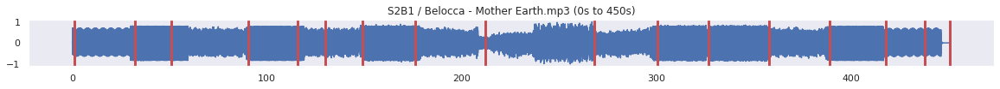

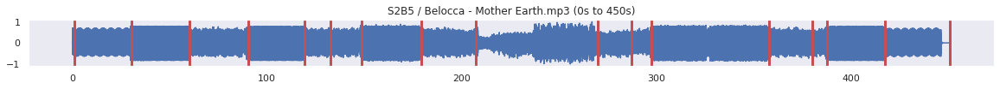

________________________________________________________________________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


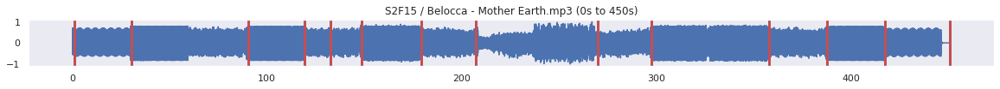

In [28]:
plot_song_and_boundaries(audio_file2, S2B1, inicio, fin, 1000)
plot_song_and_boundaries(audio_file2, S2B5, inicio, fin, 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')
S2F15=compare_array(S2B1,S2B5,ran2)
plot_song_and_boundaries(audio_file2, S2F15, inicio, fin, 1000)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


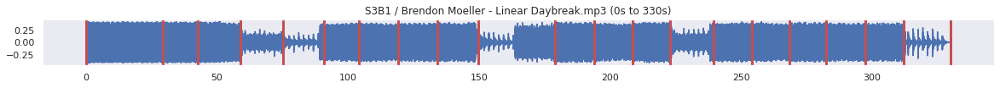

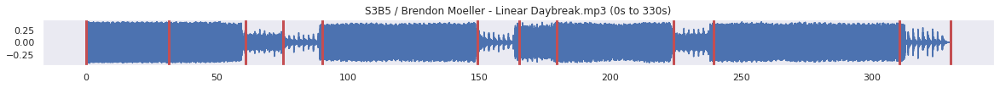

________________________________________________________________________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


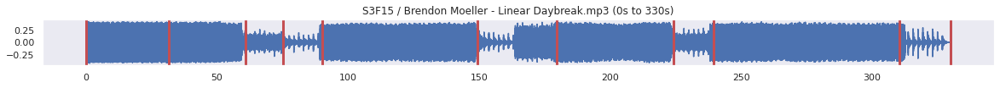

In [29]:
plot_song_and_boundaries(audio_file3, S3B1, inicio, fin, 1000)
plot_song_and_boundaries(audio_file3, S3B5, inicio, fin, 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')
S3F15=compare_array(S3B1,S3B5,ran2)
plot_song_and_boundaries(audio_file3, S3F15, inicio, fin, 1000)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


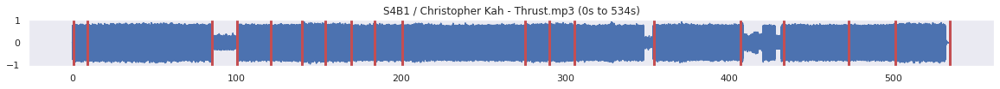

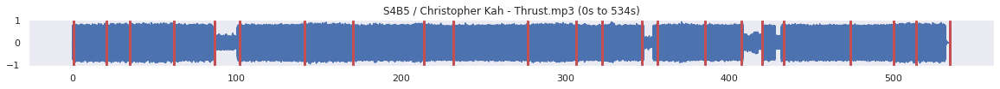

________________________________________________________________________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


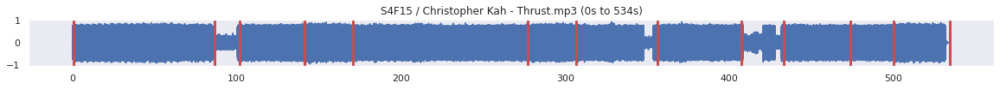

In [30]:
plot_song_and_boundaries(audio_file4, S4B1, inicio, fin, 1000)
plot_song_and_boundaries(audio_file4, S4B5, inicio, fin, 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')
S4F15=compare_array(S4B1,S4B5,ran2)
plot_song_and_boundaries(audio_file4, S4F15, inicio, fin, 1000)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


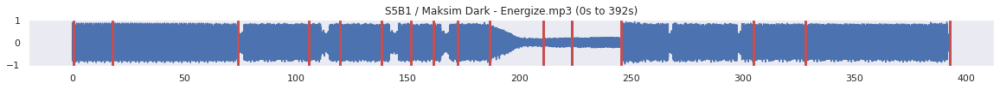

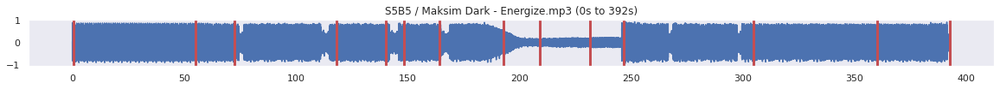

________________________________________________________________________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


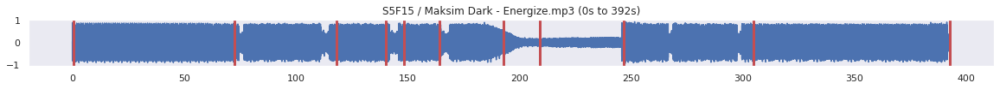

In [31]:
plot_song_and_boundaries(audio_file5, S5B1, inicio, fin, 1000)
plot_song_and_boundaries(audio_file5, S5B5, inicio, fin, 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')
S5F15=compare_array(S5B1,S5B5,ran2)
plot_song_and_boundaries(audio_file5, S5F15, inicio, fin, 1000)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


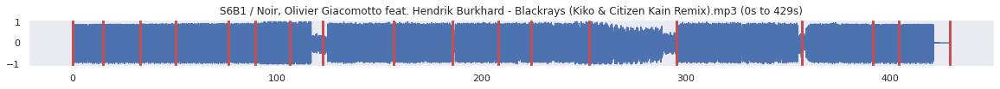

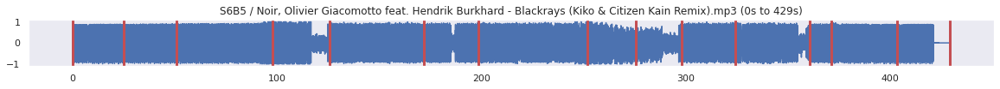

________________________________________________________________________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


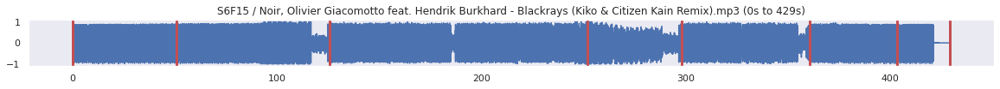

In [32]:
plot_song_and_boundaries(audio_file6, S6B1, inicio, fin, 1000)
plot_song_and_boundaries(audio_file6, S6B5, inicio, fin, 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')
S6F15=compare_array(S6B1,S6B5,ran2)
plot_song_and_boundaries(audio_file6, S6F15, inicio, fin, 1000)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


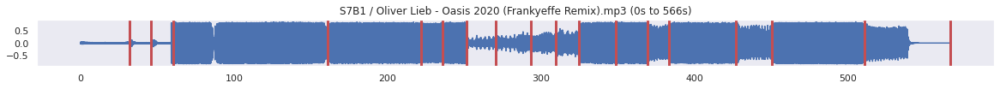

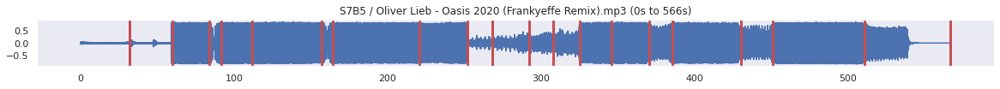

________________________________________________________________________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


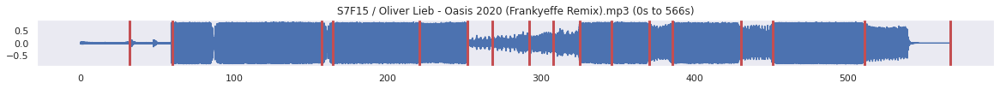

In [33]:
plot_song_and_boundaries(audio_file7, S7B1, inicio, fin, 1000)
plot_song_and_boundaries(audio_file7, S7B5, inicio, fin, 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')
S7F15=compare_array(S7B1,S7B5,ran2)
plot_song_and_boundaries(audio_file7, S7F15, inicio, fin, 1000)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


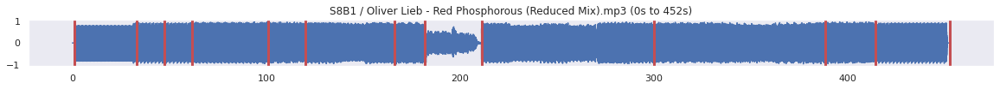

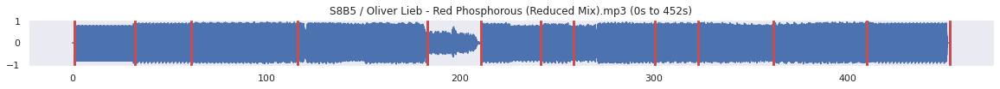

________________________________________________________________________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


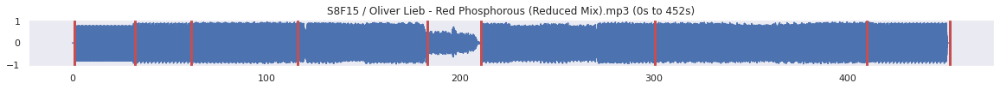

In [34]:
plot_song_and_boundaries(audio_file8, S8B1, inicio, fin, 1000)
plot_song_and_boundaries(audio_file8, S8B5, inicio, fin, 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')
S8F15=compare_array(S8B1,S8B5,ran2)
plot_song_and_boundaries(audio_file8, S8F15, inicio, fin, 1000)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


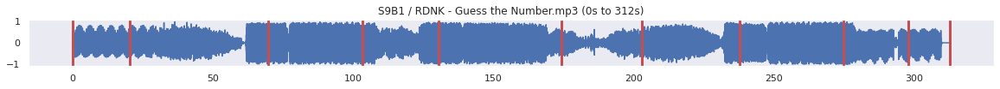

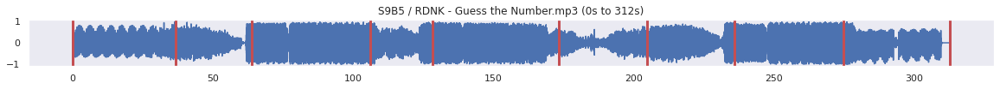

________________________________________________________________________________________________________________________________________


/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


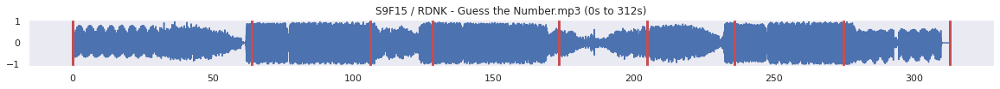

In [35]:
plot_song_and_boundaries(audio_file9, S9B1, inicio, fin, 1000)
plot_song_and_boundaries(audio_file9, S9B5, inicio, fin, 1000)
plt.show()
print('________________________________________________________________________________________________________________________________________')
S9F15=compare_array(S9B1,S9B5,ran2)
plot_song_and_boundaries(audio_file9, S9F15, inicio, fin, 1000)

Now you can compare the results for each song

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  retu

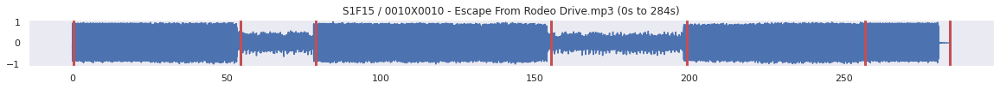

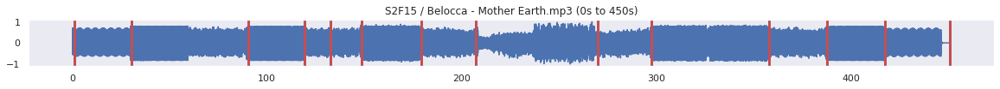

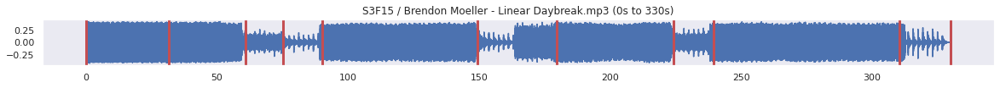

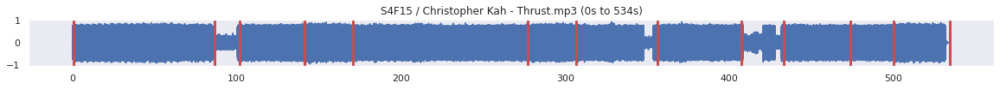

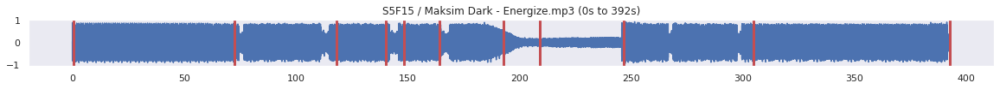

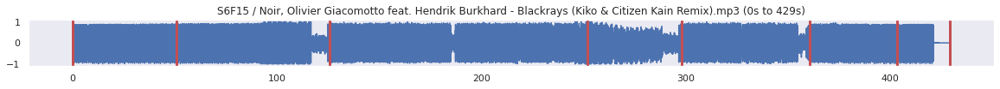

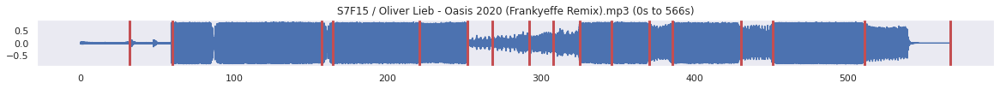

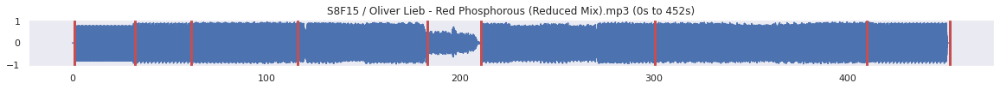

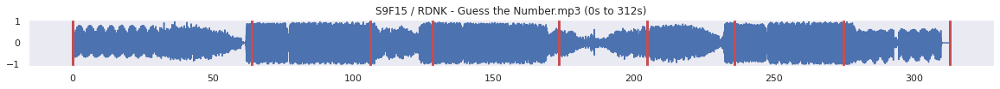

In [36]:
plot_song_and_boundaries(audio_file1, S1F15, inicio, fin, 1000)
plot_song_and_boundaries(audio_file2, S2F15, inicio, fin, 1000)
plot_song_and_boundaries(audio_file3, S3F15, inicio, fin, 1000)
plot_song_and_boundaries(audio_file4, S4F15, inicio, fin, 1000)
plot_song_and_boundaries(audio_file5, S5F15, inicio, fin, 1000)
plot_song_and_boundaries(audio_file6, S6F15, inicio, fin, 1000)
plot_song_and_boundaries(audio_file7, S7F15, inicio, fin, 1000)
plot_song_and_boundaries(audio_file8, S8F15, inicio, fin, 1000)
plot_song_and_boundaries(audio_file9, S9F15, inicio, fin, 1000)

## Filtering of boundaries

Now we filter the boundaries with the function 

```
def post_process (audio_file,boundaries,tolerance):
  # Deletes positions in boundaries and returns
  # two good candidates for the cue points
  # that indicate the fade_in and fade_out
  # 1) First and last positions are removed (if they 
  # are into the first or last 6% of the total time)
  # 2) Positions outside the tolerance range are removed
  # (i.e. if tolerance=0.8, positions outside (0%,40%)
  # and (60%, 100%) are removed.
  # 3) Returns the second and penultimate positons
  #
  # audio_file: string
  # boundaries: numpy.array
  # tolerance: float
```

You can play arround with the `tolerance` parameter to see the different results.

**Max** value for `tolerance`: `1`  (Very permissive, no effect)

**Min** value for `tolerance`: `0.06` (Too restrictive, it will not work)





[ 78.9478458  199.18077098]
[ 90.55782313 387.77324263]
[ 60.74340136 224.258322  ]
[101.65696145 473.77995465]
[118.09668934 246.7352381 ]
[126.03791383 360.93097506]
[157.19909297 450.74575964]
[ 61.16136054 300.23401361]
[106.11519274 235.7754195 ]


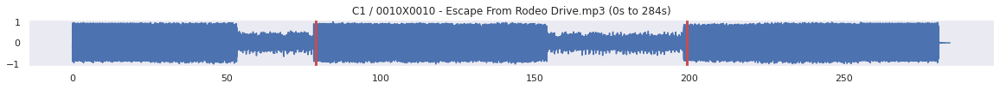

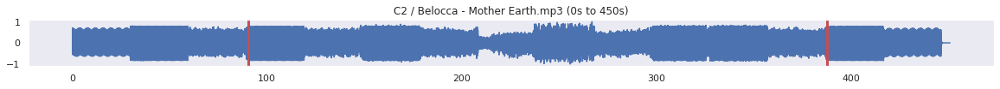

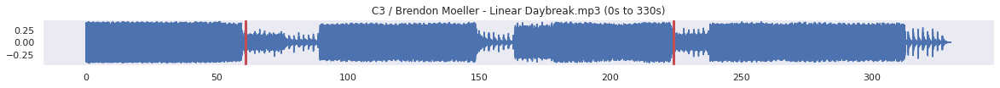

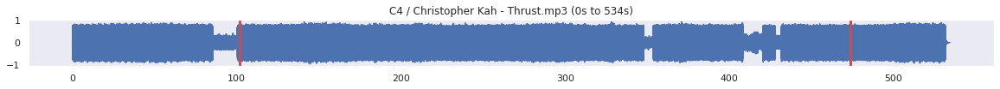

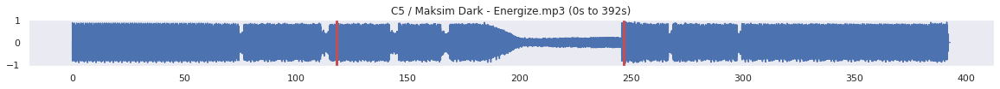

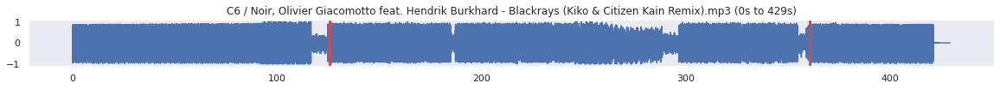

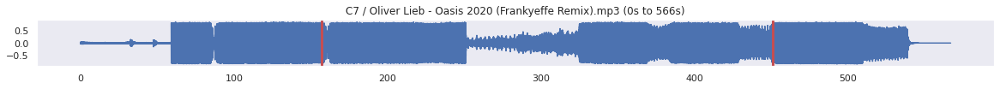

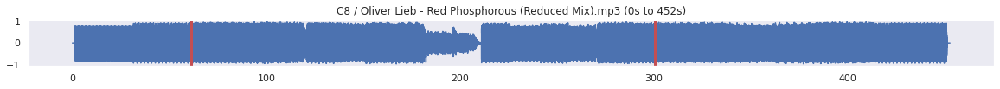

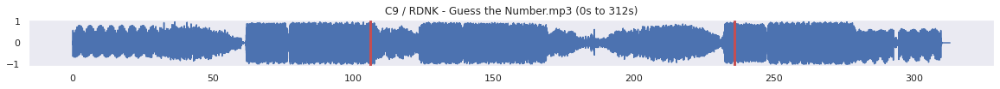

In [37]:
tolerance=0.8

C1=post_process (audio_file1,S1F15,tolerance)
print(C1)
plot_song_and_boundaries(audio_file1, C1, inicio, fin, 1000)

C2=post_process (audio_file2,S2F15,tolerance)
print(C2)
plot_song_and_boundaries(audio_file2, C2, inicio, fin, 1000)

C3=post_process (audio_file3,S3F15,tolerance)
print(C3)
plot_song_and_boundaries(audio_file3, C3, inicio, fin, 1000)

C4=post_process (audio_file4,S4F15,tolerance)
print(C4)
plot_song_and_boundaries(audio_file4, C4, inicio, fin, 1000)

C5=post_process (audio_file5,S5F15,tolerance)
print(C5)
plot_song_and_boundaries(audio_file5, C5, inicio, fin, 1000)

C6=post_process (audio_file6,S6F15,tolerance)
print(C6)
plot_song_and_boundaries(audio_file6, C6, inicio, fin, 1000)

C7=post_process (audio_file7,S7F15,tolerance)
print(C7)
plot_song_and_boundaries(audio_file7, C7, inicio, fin, 1000)

C8=post_process (audio_file8,S8F15,tolerance)
print(C8)
plot_song_and_boundaries(audio_file8, C8, inicio, fin, 1000)

C9=post_process (audio_file9,S9F15,tolerance)
print(C9)
plot_song_and_boundaries(audio_file9, C9, inicio, fin, 1000)

## Evaluation

In [1]:
# Save segments using the MIREX format
out_file = 'segments.txt'
print('Saving output to %s' % out_file)
msaf.io.write_mirex(C7, S7L5, out_file)

# Evaluate the results
try:
    evals = msaf.eval.process(audio_file7)
    print(evals)
except msaf.exceptions.NoReferencesError:
    file_struct = msaf.input_output.FileStruct(audio_file7)
    print("No references found in {}. No evaluation performed.".format(
        file_struct.ref_file))

Saving output to segments.txt


NameError: ignored

# Playing arround ##



/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, d

<Figure size 432x288 with 0 Axes>

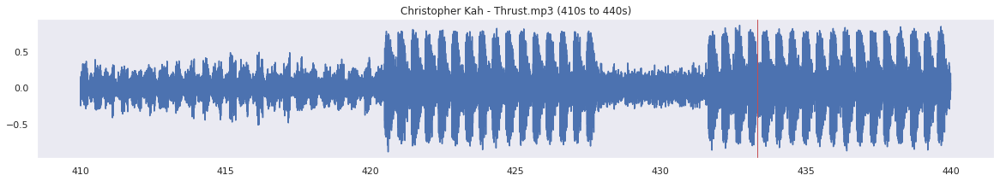

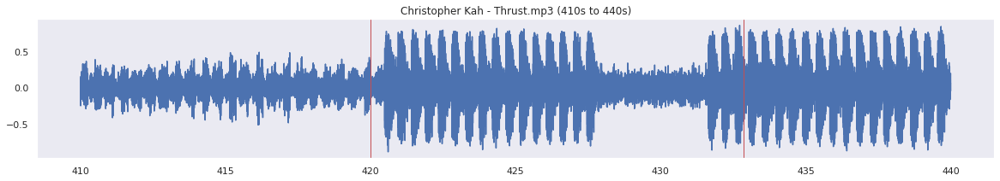

<Figure size 432x288 with 0 Axes>

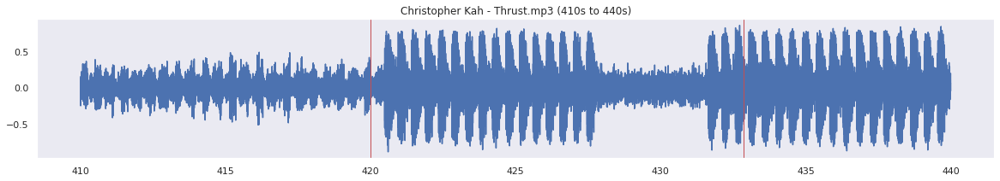

In [ ]:
audio_file = "autocue/audio/Christopher Kah - Thrust.mp3"
IPython.display.Audio(filename=audio_file)

plt.figure(1)
boundaries, labels = msaf.process(audio_file)
plot_song_and_boundaries(audio_file, boundaries, 410, 440, 1000)
plt.figure(2)
boundaries, labels = msaf.process(audio_file, boundaries_id="foote", labels_id="fmc2d")
plot_song_and_boundaries(audio_file, boundaries, 410, 440, 1000)
#plt.figure(3)
#boundaries, labels = msaf.process(audio_file, feature="mfcc", boundaries_id="cnmf", 
#                                  labels_id="fmc2d")
#plot_song_and_boundaries(audio_file, boundaries, 0, -1, 1000)
plt.figure(5)
boundaries, labels = msaf.process(audio_file, boundaries_id="foote", 
                                  labels_id="fmc2d")
plot_song_and_boundaries(audio_file, boundaries, 410, 440, 1000)

## boundaries_id="foote"

In [ ]:
audio_file = "autocue/audio/Christopher Kah - Thrust.mp3"

#Available boundary algorithms
#['foote', 'sf', 'olda', 'vmo', 'example', 'scluster', 'cnmf']

#Available feautres
#{'cqt', 'mfcc', 'pcp', 'tonnetz', 'tempogram'}
plt.figure(1)
boundarie1, labels = msaf.process(audio_file)

plt.figure(2)
boundarie2, labels = msaf.process(audio_file, feature="cqt", boundaries_id="foote", labels_id="fmc2d")

plt.figure(4)
boundarie4, labels = msaf.process(audio_file, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  retu

<Figure size 432x288 with 0 Axes>

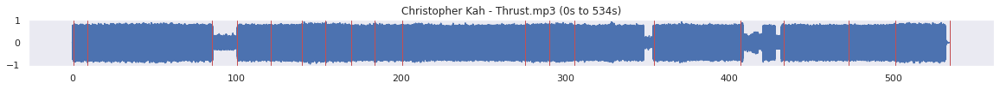

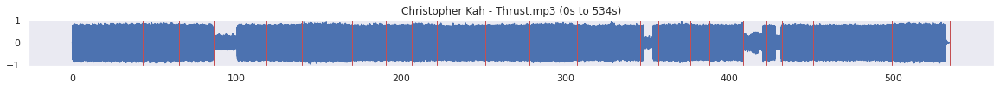

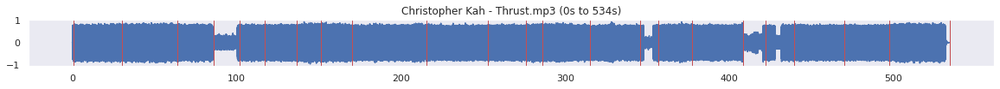

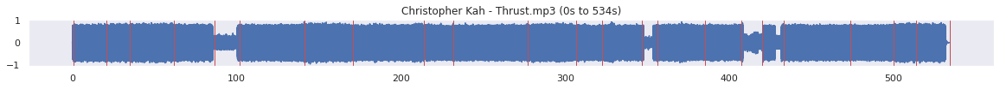

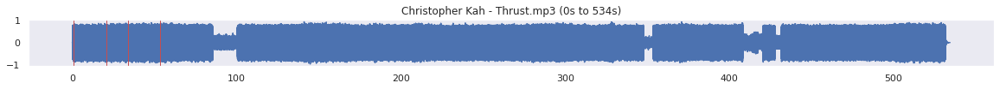

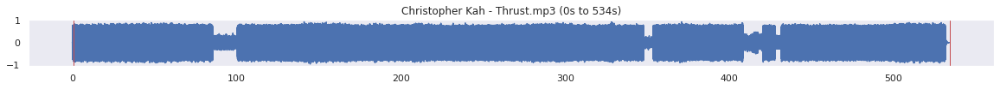

In [ ]:
plt.figure(1)

plot_song_and_boundaries(audio_file, boundarie1, 0, -1, 1000)
plt.figure(2)

plot_song_and_boundaries(audio_file, boundarie2, 0, -1, 1000)
plt.figure(3)

plot_song_and_boundaries(audio_file, boundarie3, 0, -1, 1000)
plt.figure(4)

plot_song_and_boundaries(audio_file, boundarie4, 0, -1, 1000)

## boundaries_id="sf"

In [ ]:
audio_file = "autocue/audio/Christopher Kah - Thrust.mp3"

#Available boundary algorithms
#['foote', 'sf', 'olda', 'vmo', 'example', 'scluster', 'cnmf']

#Available feautres
#{'cqt', 'mfcc', 'pcp', 'tonnetz', 'tempogram'}

boundaries1, labels = msaf.process(audio_file)
boundaries2, labels = msaf.process(audio_file, feature="cqt", boundaries_id="sf", labels_id="fmc2d")
boundaries4, labels = msaf.process(audio_file, feature="pcp", boundaries_id="sf", labels_id="fmc2d")

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  retu

<Figure size 432x288 with 0 Axes>

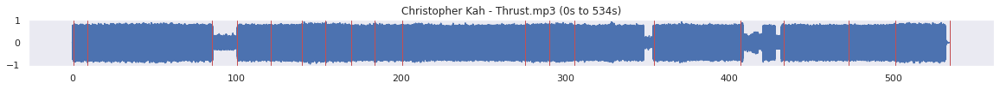

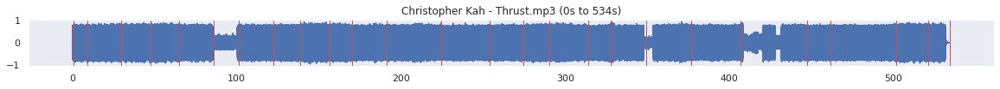

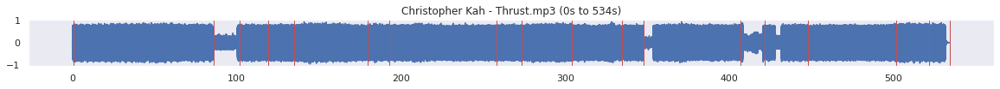

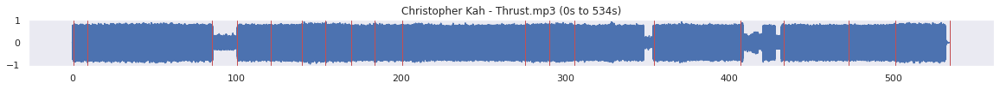

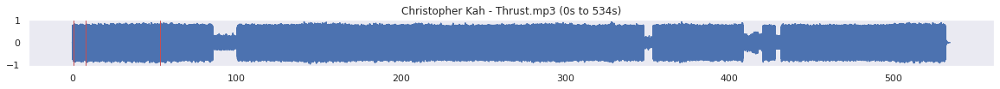

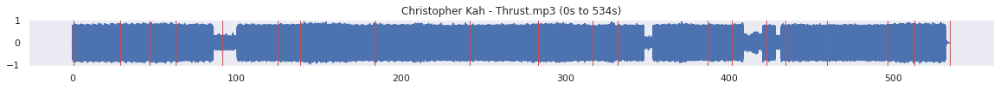

In [ ]:
plt.figure(1)

plot_song_and_boundaries(audio_file, boundaries1, 0, -1, 1000)
plt.figure(2)

plot_song_and_boundaries(audio_file, boundaries2, 0, -1, 1000)

plt.figure(4)

plot_song_and_boundaries(audio_file, boundaries4, 0, -1, 1000)

## boundaries_id="olda"  (good, doesn't change with the features)

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWa

<Figure size 432x288 with 0 Axes>

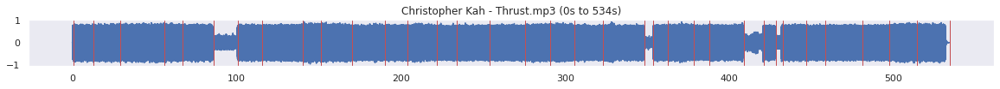

In [4]:
audio_file = "autocue/audio/Christopher Kah - Thrust.mp3"

#Available boundary algorithms
#['foote', 'sf', 'olda', 'vmo', 'example', 'scluster', 'cnmf']

#Available feautres
#{'cqt', 'mfcc', 'pcp', 'tonnetz', 'tempogram'}

boundaries2, labels = msaf.process(audio_file, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
plt.figure(2)
plot_song_and_boundaries(audio_file, boundaries2, 0, -1, 1000)


## boundaries_id="vmo"

Good for beat tracking

cqt + vmo = all beats

mfcc + vmo = only kicks (low beat)

In [ ]:
audio_file = "autocue/audio/Christopher Kah - Thrust.mp3"

#Available boundary algorithms
#['foote', 'sf', 'olda', 'vmo', 'example', 'scluster', 'cnmf']

#Available feautres
#{'cqt', 'mfcc', 'pcp', 'tonnetz', 'tempogram'}

boundaries2, labels = msaf.process(audio_file, feature="cqt", boundaries_id="vmo", labels_id="fmc2d")
boundaries3, labels = msaf.process(audio_file, feature="mfcc", boundaries_id="vmo", labels_id="fmc2d")

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


<Figure size 432x288 with 0 Axes>

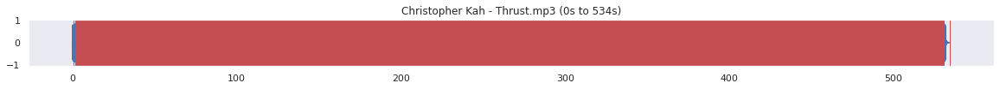

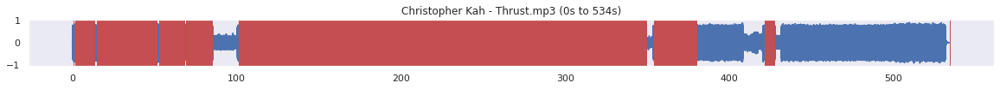

In [ ]:
plt.figure(2)
plot_song_and_boundaries(audio_file, boundaries2, 0, -1, 1000)

plt.figure(3)
plot_song_and_boundaries(audio_file, boundaries3, 0, -1, 1000)

## boundaries_id="scluster" (ES MUY BUENO!, no cambia con features)

In [ ]:
audio_file = "autocue/audio/Christopher Kah - Thrust.mp3"

#Available boundary algorithms
#['foote', 'sf', 'olda', 'vmo', 'example', 'scluster', 'cnmf']

#Available feautres
#{'cqt', 'mfcc', 'pcp', 'tonnetz', 'tempogram'}

boundaries1, labels = msaf.process(audio_file, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
boundaries2, labels = msaf.process(audio_file, feature="mfcc", boundaries_id="scluster", labels_id="fmc2d")
boundaries3, labels = msaf.process(audio_file, feature="pcp", boundaries_id="scluster", labels_id="fmc2d")
boundaries5, labels = msaf.process(audio_file, feature="tempogram", boundaries_id="scluster", labels_id="fmc2d")

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


<Figure size 432x288 with 0 Axes>

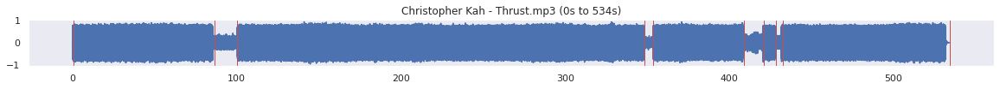

In [ ]:
plt.figure(1)
plot_song_and_boundaries(audio_file, boundaries1, 0, -1, 1000)

## LOS BUENOS

/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:


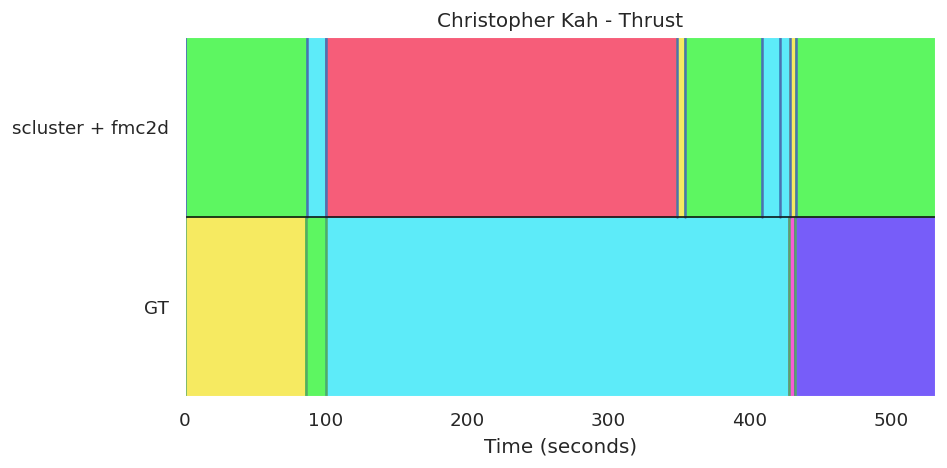

/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x

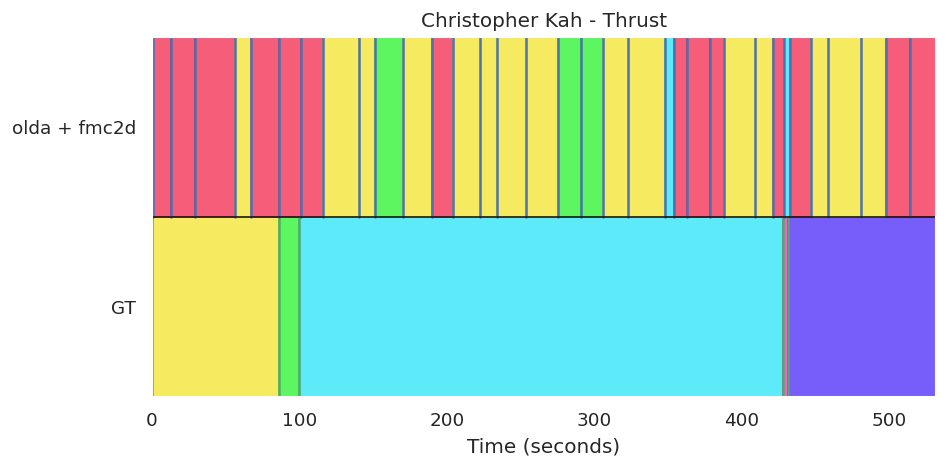

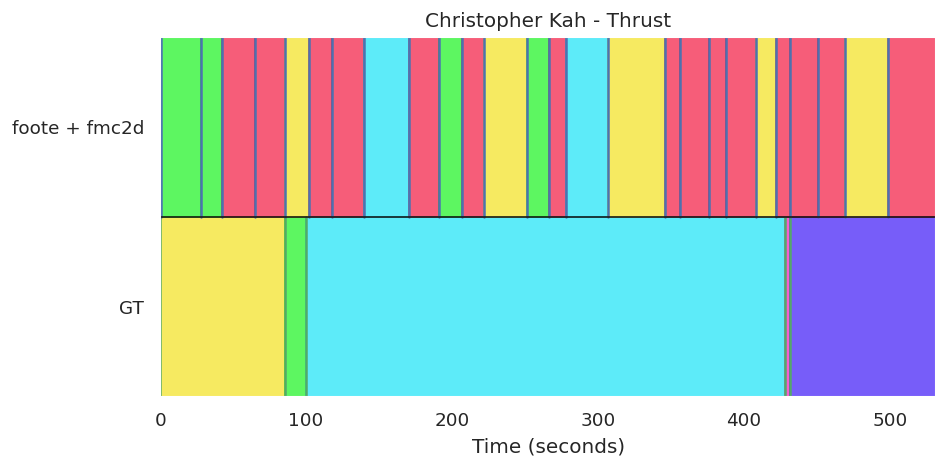

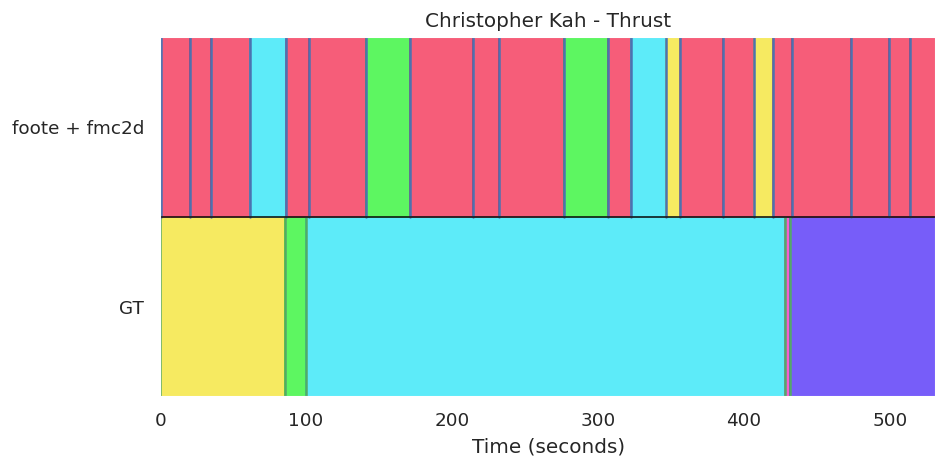

/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:


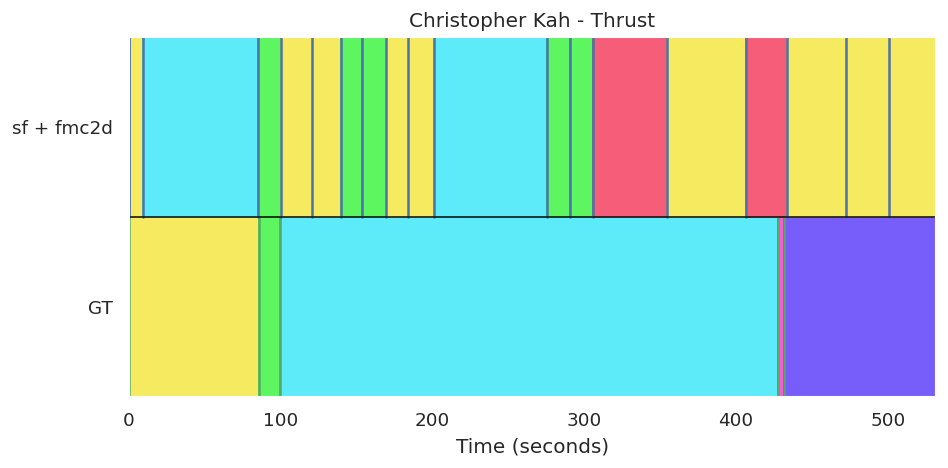

In [6]:
audio_file = "autocue/audio/Christopher Kah - Thrust.mp3"
boundaries1, labels1 = msaf.process(audio_file, feature="pcp", boundaries_id="sf", labels_id="fmc2d",plot=True)
boundaries2, labels2 = msaf.process(audio_file, feature="cqt", boundaries_id="scluster", labels_id="fmc2d",plot=True)
boundaries3, labels3 = msaf.process(audio_file, feature="pcp", boundaries_id="olda", labels_id="fmc2d",plot=True)
boundaries4, labels4 = msaf.process(audio_file, feature="cqt", boundaries_id="foote", labels_id="fmc2d",plot=True)
boundaries5, labels5 = msaf.process(audio_file, feature="pcp", boundaries_id="foote", labels_id="fmc2d",plot=True)


/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32,

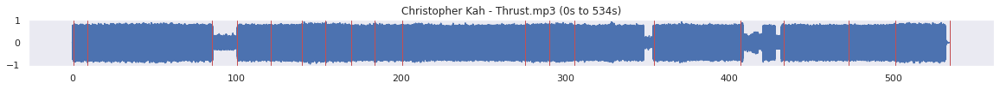

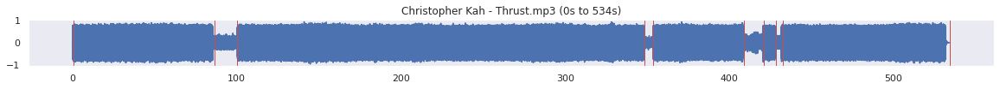

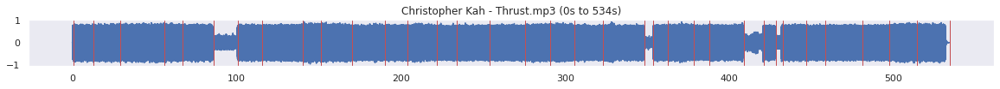

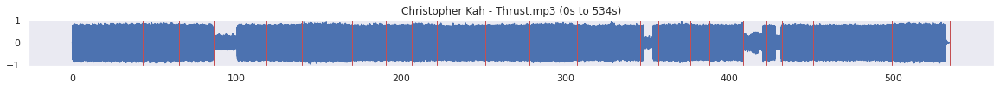

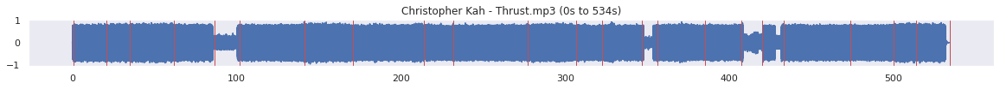

In [334]:
audio_file = "autocue/audio/Christopher Kah - Thrust.mp3"
boundaries1, labels1 = msaf.process(audio_file, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
boundaries2, labels2 = msaf.process(audio_file, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
boundaries3, labels3 = msaf.process(audio_file, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
boundaries4, labels4 = msaf.process(audio_file, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
boundaries5, labels5 = msaf.process(audio_file, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

plot_song_and_boundaries(audio_file, boundaries1, 0, -1, 1000)
plot_song_and_boundaries(audio_file, boundaries2, 0, -1, 1000)
plot_song_and_boundaries(audio_file, boundaries3, 0, -1, 1000)
plot_song_and_boundaries(audio_file, boundaries4, 0, -1, 1000)
plot_song_and_boundaries(audio_file, boundaries5, 0, -1, 1000)

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


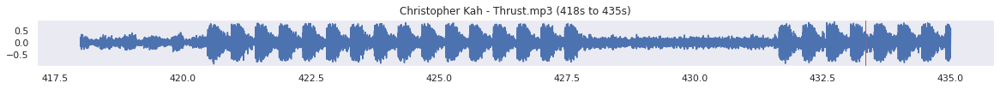

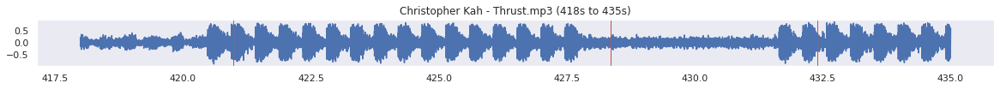

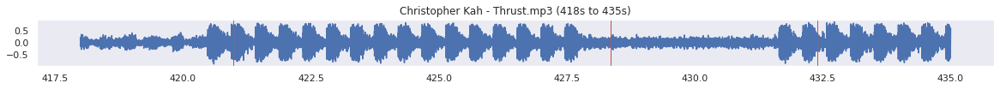

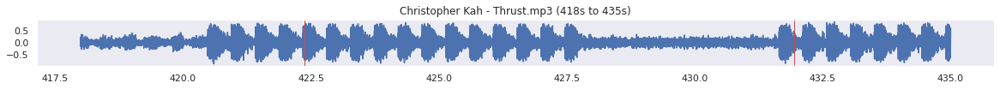

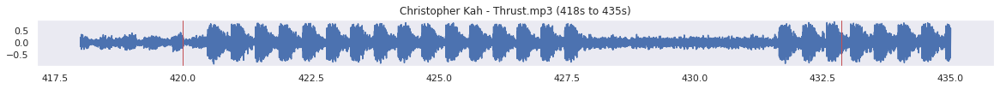

In [25]:
plot_song_and_boundaries(audio_file, boundaries1, 418, 435, 1000)
plot_song_and_boundaries(audio_file, boundaries2, 418, 435, 1000)
plot_song_and_boundaries(audio_file, boundaries3, 418, 435, 1000)
plot_song_and_boundaries(audio_file, boundaries4, 418, 435, 1000)
plot_song_and_boundaries(audio_file, boundaries5, 418, 435, 1000)

In [5]:
import bisect

def filter_in_range (center_num,filtering_array,allowed_range):

  lower_bound=center_num-allowed_range
  upper_bound=center_num+allowed_range

  lower_bound_i = bisect.bisect_left(filtering_array, lower_bound)
  upper_bound_i = bisect.bisect_right(filtering_array, upper_bound, lo=lower_bound_i)
  nums = filtering_array[lower_bound_i:upper_bound_i]
  return nums
  
def compare_array(array1,array2,allowed_range):
  filtered = np.empty((min(len(array1),len(array2)), 1))
  index=0
  it=iter(array1)
  for i in it:
    if len(filter_in_range(i,array2,allowed_range))>1:
      for t in range(len(filter_in_range(i,array2,allowed_range))):
        filtered[index]=filter_in_range(i,array2,allowed_range)[t]
        index=index+1
      i = next(it)
    if len(filter_in_range(i,array2,allowed_range))==1:
      filtered[index]=filter_in_range(i,array2,allowed_range)
      index=index+1
  retorno = np.empty((index, 1))
  for u in range(index):
    retorno[u]=filtered[u]
  return retorno

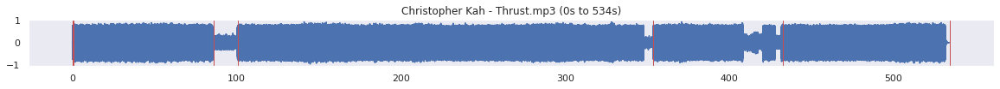

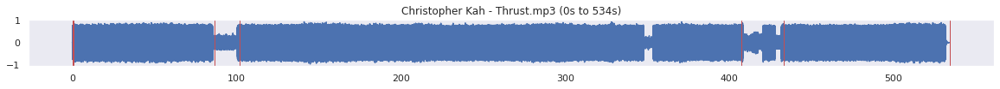

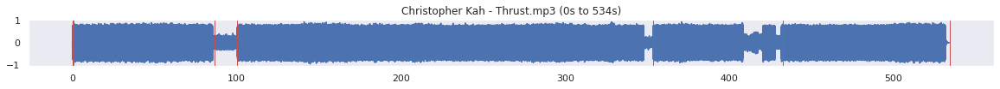

In [335]:
ran=1.4
ran2=ran*2
AAS=compare_array(boundaries1,compare_array(boundaries5,compare_array(boundaries2,compare_array(boundaries1,compare_array(boundaries3,boundaries3,ran2),ran2),ran2),ran2),ran)
plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)
AAS=compare_array(boundaries1,compare_array(boundaries1,compare_array(boundaries2,compare_array(boundaries3,compare_array(boundaries5,boundaries5,ran2),ran2),ran2),ran2),ran)
plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)
AAS=compare_array(boundaries1,compare_array(boundaries1,compare_array(boundaries5,compare_array(boundaries3,compare_array(boundaries2,boundaries2,ran2),ran2),ran2),ran2),ran)
plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)

In [41]:
audio_file = "autocue/audio/Oliver Lieb - Red Phosphorous (Reduced Mix).mp3"
boundaries1, labels1 = msaf.process(audio_file, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# boundaries2, labels2 = msaf.process(audio_file, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
boundaries3, labels3 = msaf.process(audio_file, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# boundaries4, labels4 = msaf.process(audio_file, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
boundaries5, labels5 = msaf.process(audio_file, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

# plot_song_and_boundaries(audio_file, boundaries1, 0, -1, 1000)
# plot_song_and_boundaries(audio_file, boundaries2, 0, -1, 1000)
# plot_song_and_boundaries(audio_file, boundaries3, 0, -1, 1000)
# plot_song_and_boundaries(audio_file, boundaries4, 0, -1, 1000)
# plot_song_and_boundaries(audio_file, boundaries5, 0, -1, 1000)

# ran=1.4
# ran2=ran*2
# AAS=compare_array(boundaries1,compare_array(boundaries5,compare_array(boundaries2,compare_array(boundaries1,compare_array(boundaries3,boundaries4,ran2),ran2),ran2),ran2),ran)
# plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)
# AAS=compare_array(boundaries1,compare_array(boundaries1,compare_array(boundaries2,compare_array(boundaries3,compare_array(boundaries4,boundaries5,ran2),ran2),ran2),ran2),ran)
# plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)
# AAS=compare_array(boundaries1,compare_array(boundaries1,compare_array(boundaries5,compare_array(boundaries3,compare_array(boundaries4,boundaries2,ran2),ran2),ran2),ran2),ran)
# plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32,

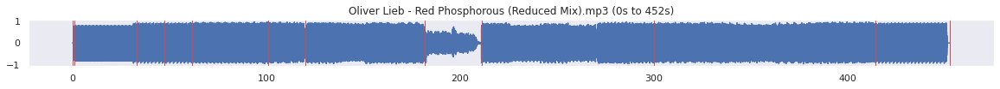

In [43]:
ran=3.4
ran2=ran*2
# AAS=compare_array(boundaries1,compare_array(boundaries5,compare_array(boundaries2,compare_array(boundaries1,compare_array(boundaries3,boundaries3,ran2),ran2),ran2),ran2),ran)
# plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)
# AAS=compare_array(boundaries1,compare_array(boundaries1,compare_array(boundaries2,compare_array(boundaries3,compare_array(boundaries5,boundaries5,ran2),ran2),ran2),ran2),ran)
# plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)
# AAS=compare_array(boundaries1,compare_array(boundaries1,compare_array(boundaries5,compare_array(boundaries3,compare_array(boundaries2,boundaries2,ran2),ran2),ran2),ran2),ran)
# plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)
AAS=compare_array(boundaries3,compare_array(boundaries3,boundaries1,ran2),ran)
plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)

In [38]:
import bisect

def filter_in_range (center_num,filtering_array,allowed_range):

  lower_bound=center_num-allowed_range
  upper_bound=center_num+allowed_range

  lower_bound_i = bisect.bisect_left(filtering_array, lower_bound)
  upper_bound_i = bisect.bisect_right(filtering_array, upper_bound, lo=lower_bound_i)
  nums = filtering_array[lower_bound_i:upper_bound_i]
  return nums
  
def compare_array(array1,array2,allowed_range):
  filtered = np.empty((min(len(array1),len(array2)), 1))
  index=0
  it=iter(array1)
  for i in it:
    if index<len(filtered):
      if len(filter_in_range(i,array2,allowed_range))>1:
        for t in range(len(filter_in_range(i,array2,allowed_range))):
          if index<len(filtered):
            filtered[index]=filter_in_range(i,array2,allowed_range)[t]
            index=index+1
        i = next(it)
      if len(filter_in_range(i,array2,allowed_range))==1:
        filtered[index]=filter_in_range(i,array2,allowed_range)
        index=index+1
  retorno = np.empty((index, 1))
  for u in range(index):
    retorno[u]=filtered[u]
  return retorno

In [44]:
  audio_file = "autocue/audio/Oliver Lieb - Oasis 2020 (Frankyeffe Remix).mp3"
  boundaries1, labels1 = msaf.process(audio_file, feature="pcp", boundaries_id="sf", labels_id="fmc2d")
# # #boundaries2, labels2 = msaf.process(audio_file, feature="cqt", boundaries_id="scluster", labels_id="fmc2d")
  boundaries3, labels3 = msaf.process(audio_file, feature="pcp", boundaries_id="olda", labels_id="fmc2d")
# # #boundaries4, labels4 = msaf.process(audio_file, feature="cqt", boundaries_id="foote", labels_id="fmc2d")
  boundaries5, labels5 = msaf.process(audio_file, feature="pcp", boundaries_id="foote", labels_id="fmc2d")

  plot_song_and_boundaries(audio_file, boundaries1, 0, -1, 1000)
# # #plot_song_and_boundaries(audio_file, boundaries2, 0, -1, 1000)
  plot_song_and_boundaries(audio_file, boundaries3, 0, -1, 1000)
# # #plot_song_and_boundaries(audio_file, boundaries4, 0, -1, 1000)
  plot_song_and_boundaries(audio_file, boundaries5, 0, -1, 1000)

ran=3.4
ran2=ran*2

AAS=compare_array(boundaries1,compare_array(boundaries3,boundaries5,ran2),ran)
plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)
AAS=compare_array(boundaries5,compare_array(boundaries3,boundaries1,ran2),ran)
plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)
AAS=compare_array(boundaries3,compare_array(boundaries5,boundaries1,ran2),ran)
plot_song_and_boundaries(audio_file, AAS, 0, -1, 1000)

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32,

KeyboardInterrupt: ignored

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


<Figure size 432x288 with 0 Axes>

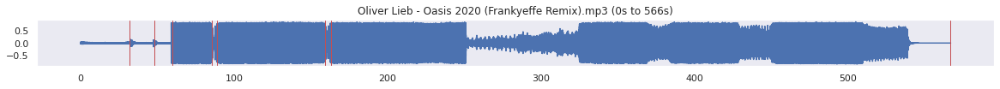

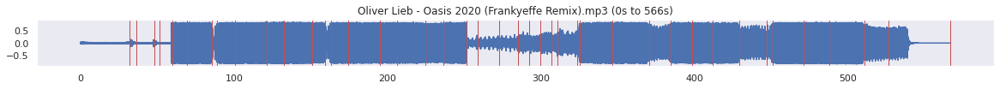

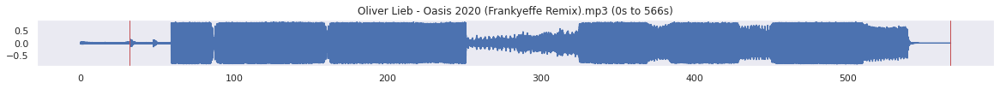

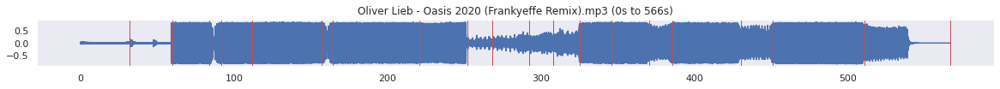

<Figure size 432x288 with 0 Axes>

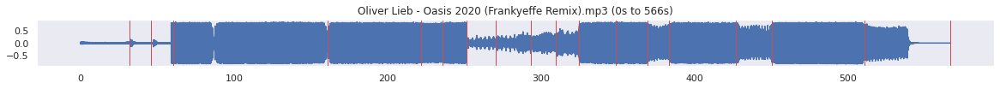

In [ ]:
#plt.figure(1)
#plot_song_and_boundaries(audio_file, boundaries1, 0, -1, 1000)
plt.figure(2)
plot_song_and_boundaries(audio_file, boundaries2, 0, -1, 1000)
plt.figure(3)
plot_song_and_boundaries(audio_file, boundaries3, 0, -1, 1000)
plt.figure(4)
plot_song_and_boundaries(audio_file, boundaries4, 0, -1, 1000)
plt.figure(5)
plot_song_and_boundaries(audio_file, boundaries5, 0, -1, 1000)
plt.figure(7)
plot_song_and_boundaries(audio_file, boundaries7, 0, -1, 1000)

/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:


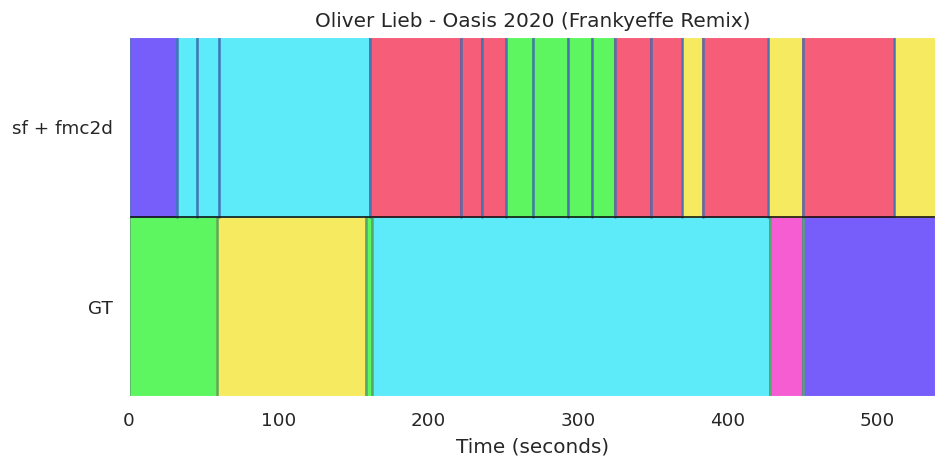

In [ ]:
boundaries1, labels = msaf.process(audio_file,labels_id="fmc2d",plot=True)

## Single File Mode ##

This mode analyzes one audio file at a time.

**Note**: Make sure to download the datasets from git clone https://github.com/gbibbo/autocue.git

In [ ]:
# Choose an audio file and listen to it
audio_file = "autocue/audio/Christopher Kah - Thrust.mp3"
IPython.display.Audio(filename=audio_file)

In [ ]:
# Segment the file using the default MSAF parameters
boundaries, labels = msaf.process(audio_file)
print(boundaries)
plot_song_and_boundaries(audio_file, boundaries, 0, -1, 44100)

/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:518: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not x.flags.writeable:


TypeError: ignored

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32,

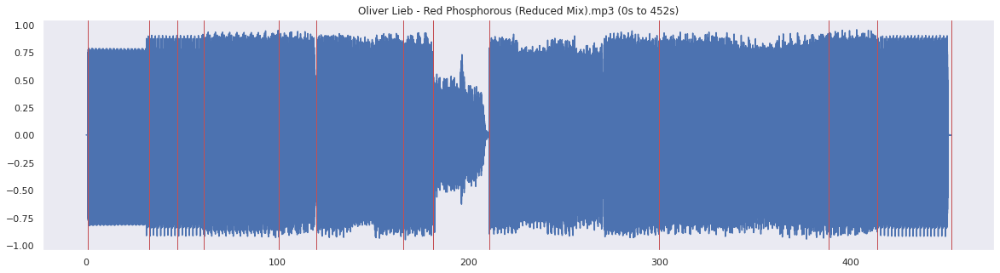

In [ ]:
audio_file = "autocue/audio/Oliver Lieb - Red Phosphorous (Reduced Mix).mp3"
boundaries, labels = msaf.process(audio_file)
plot_song_and_boundaries(audio_file, boundaries, 0, -1, 1000)

In [ ]:
# # Sonify boundaries
# sonified_file = "my_boundaries.wav"
# sr = 44100
# boundaries, labels = msaf.process(audio_file, sonify_bounds=True, 
#                                   out_bounds=sonified_file, out_sr=sr)

# # Listen to results
# audio = librosa.load(sonified_file, sr=sr)[0]
# IPython.display.Audio(audio, rate=sr)

# plot_song_and_boundaries(audio_file, boundaries, 0, 110, 1000)

### Using different Algorithms ###

MSAF includes multiple algorithms both for boundary retrieval and structural grouping (or labeling). In this section we demonstrate how to try them out.

Note: more algorithms are available in [msaf-gpl](https://github.com/urinieto/msaf-gpl).

In [ ]:
# First, let's list all the available boundary algorithms
print(msaf.get_all_boundary_algorithms())

['foote', 'sf', 'olda', 'vmo', 'example', 'scluster', 'cnmf']


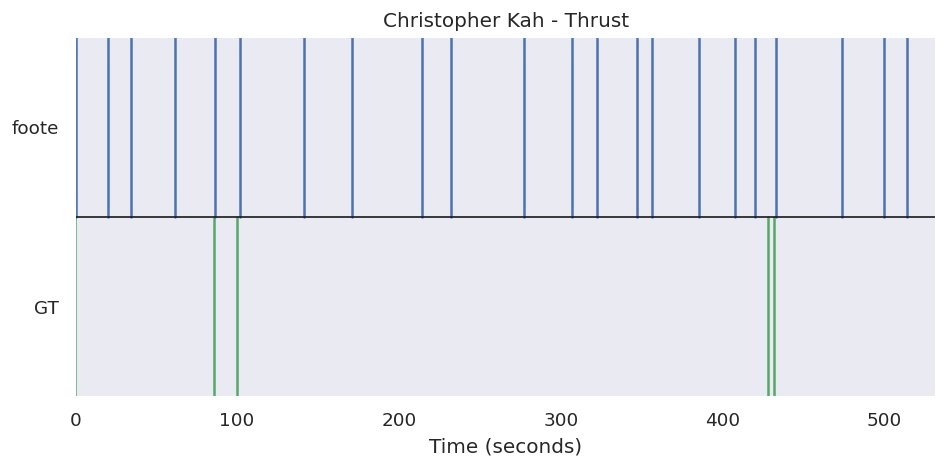

TypeError: ignored

In [ ]:
# Try one of these boundary algorithms and print results
boundaries, labels = msaf.process(audio_file, boundaries_id="foote", plot=True)

In [ ]:
# Let's check all the structural grouping (label) algorithms available
print(msaf.get_all_label_algorithms())

In [ ]:
# Try one of these label algorithms
boundaries, labels = msaf.process(audio_file, boundaries_id="foote", labels_id="fmc2d")
print(boundaries)
print(labels)
plot_song_and_boundaries(audio_file, boundaries, 0, 110, 1000)

In [ ]:
# If available, you can use previously annotated boundaries and a specific labels algorithm
# Set plot = True to plot the results
boundaries, labels = msaf.process(audio_file, boundaries_id="foote", 
                                  labels_id="fmc2d", plot=True)

plot_song_and_boundaries(audio_file, boundaries, 0, 110, 1000)

### Using different Features ###

Some algorithms allow the input of different type of features (e.g., harmonic, timbral). In this section we show how we can input different features to MSAF.

In [ ]:
# Let's check what available features are there in MSAF
print(msaf.features_registry)

{'cqt': <class 'msaf.features.CQT'>, 'mfcc': <class 'msaf.features.MFCC'>, 'pcp': <class 'msaf.features.PCP'>, 'tonnetz': <class 'msaf.features.Tonnetz'>, 'tempogram': <class 'msaf.features.Tempogram'>}


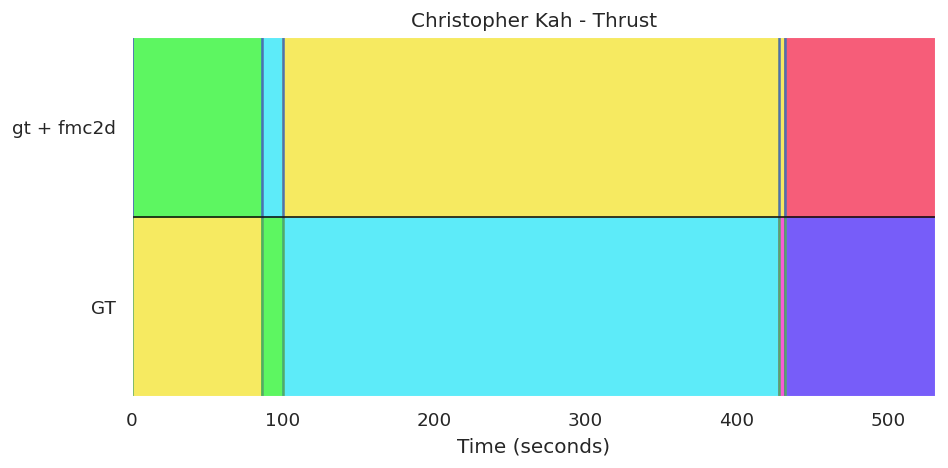

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


[0.00000000e+00 5.10839002e-01 8.58673923e+01 9.97993651e+01
 4.27943764e+02 4.31937596e+02 5.34291156e+02 5.34320635e+02]


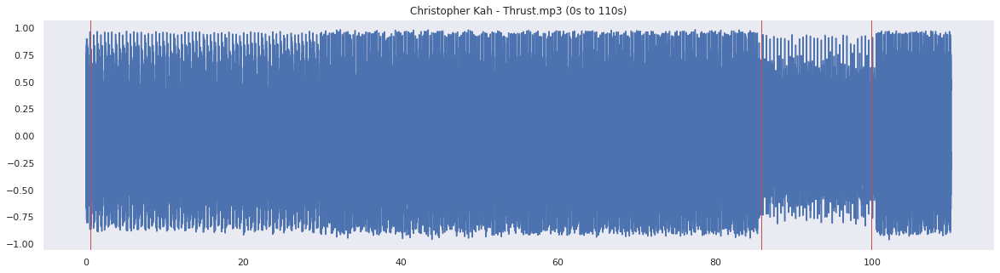

In [ ]:
# Segment the file using the Foote method for boundaries, C-NMF method for labels, and MFCC features
boundaries, labels = msaf.process(audio_file, feature="mfcc", boundaries_id="gt", 
                                  labels_id="fmc2d", plot=True)

plot_song_and_boundaries(audio_file, boundaries, 0, 110, 44100)

### Using Annotated Beats ###

MSAF can calculate the beats or use annotated ones. The annotations should be store in a jams file, for this notebook we used a [simple jams example](http://pythonhosted.org/jams/examples.html). 

In [ ]:
sr = 44100
hop_length = 1024
#beats_audio_file = "../datasets/Sargon/audio/02-Sargon-Shattered World.mp3"
beats_audio_file = "msaf-data/Sargon/audio/02-Sargon-Shattered World.mp3"
audio = librosa.load(beats_audio_file, sr=sr)[0]
audio_harmonic, audio_percussive = librosa.effects.hpss(audio)

# Compute beats
tempo, frames = librosa.beat.beat_track(y=audio_percussive, 
                                        sr=sr, hop_length=hop_length)

# To times
beat_times = librosa.frames_to_time(frames, sr=sr, 
                                    hop_length=hop_length)

plot_song_and_boundaries(beats_audio_file, beat_times, 0, 70, 44100)


/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")


FileNotFoundError: ignored

In [ ]:
plot_song_and_boundaries(beats_audio_file, beat_times, 15, 18, 44100)

In [ ]:
#  We will now save or beats to a JAMS file.
import jams

jam = jams.JAMS()
jam.file_metadata.duration = len(audio_file)/sr
beat_a = jams.Annotation(namespace='beat')
beat_a.annotation_metadata = jams.AnnotationMetadata(data_source='librosa beat tracker')

#  Add beat timings to the annotation record.
#  The beat namespace does not require value or confidence fields,
#  so we can leave those blank.
for t in beat_times:
    beat_a.append(time=t, duration=0.0)

#  Store the new annotation in the jam file. This need to be located on the references folder
#  and be named like the audio file except for the jams extension.
jam.annotations.append(beat_a)
jam.save('msaf-data/Sargon/references/02-Sargon-Shattered World.jams')

In [ ]:
#  Using the annotated beats then is straight forward.
#  Just be sure you don't have a temporary features file in the directory.

boundaries, labels = msaf.process(audio_file, boundaries_id="foote", 
                                  annot_beats=True, labels_id="fmc2d", plot=True)

### Evaluate Results ###

The results can be evaluated as long as there is an existing file containing reference annotations. The results are stored in a pandas DataFrame. MSAF has to run these algorithms (using `msaf.process` described above) before being able to evaluate its results.

In [ ]:
# Evaluate the results. It returns a pandas data frame.
evaluations = msaf.eval.process(audio_file, boundaries_id="foote", labels_id="fmc2d")
IPython.display.display(evaluations)

,D,DevE2R,DevR2E,DevtE2R,DevtR2E,HitRate_0.5F,HitRate_0.5P,HitRate_0.5R,HitRate_3F,HitRate_3P,HitRate_3R,HitRate_t0.5F,HitRate_t0.5P,HitRate_t0.5R,HitRate_t3F,HitRate_t3P,HitRate_t3R,HitRate_w0.5F,HitRate_w3F,HitRate_wt0.5F,HitRate_wt3F,PWF,PWP,PWR,Sf,So,Su,ds_name,track_id
0,0.461376,0.78882,0.814265,1.06025,0.94998,0.285714,0.28,0.291667,0.77551,0.76,0.791667,0.222222,0.217391,0.227273,0.755556,0.73913,0.772727,0.282848,0.76773,0.219797,0.747309,0.432715,0.298195,0.788352,0.575848,0.783025,0.455365,01-Sargon-Mindless.jams,01-Sargon-Mindless


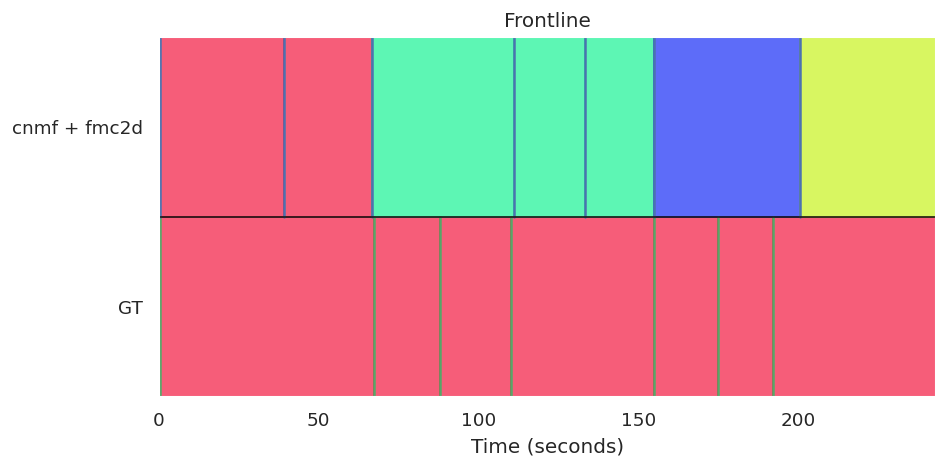

NoEstimationsError: ignored

In [ ]:
boundaries, labels = msaf.process("/content/drive/MyDrive/MIR/Frontline.mp3", feature="mfcc", boundaries_id="cnmf", 
                                  labels_id="fmc2d", plot=True)
evaluations = msaf.eval.process("/content/drive/MyDrive/MIR/Frontline.mp3", boundaries_id="sf", labels_id="fmc2d")
IPython.display.display(evaluations)

### Explore Algorithm Parameters ###

Now let's modify the configuration of one of the files, and modify it to see how different the results are.
We will use Widgets, which will become handy here.

In [ ]:
# First, check which are foote's algorithm parameters:
print(msaf.algorithms.foote.config)

{'M_gaussian': 66, 'm_median': 12, 'L_peaks': 64, 'bound_norm_feats': 'min_max'}


In [ ]:
# play around with IPython.Widgets
from ipywidgets import interact

# Obtain the default configuration
bid = "foote"  # Boundaries ID
lid = None     # Labels ID
feature = "pcp"
config = msaf.io.get_configuration(feature, annot_beats=False, framesync=False, 
                                   boundaries_id=bid, labels_id=lid)

# Sweep M_gaussian parameters
@interact(M_gaussian=(50, 500, 25))
def _run_msaf(M_gaussian):
    # Set the configuration
    config["M_gaussian"] = M_gaussian
    
    # Segment the file using the Foote method, and Pitch Class Profiles for the features
    results = msaf.process(audio_file, feature=feature, boundaries_id=bid, 
                           config=config, plot=True)

    # Evaluate the results. It returns a pandas data frame.
    evaluations = msaf.eval.process(audio_file, feature=feature, boundaries_id=bid,
                                    config=config)
    IPython.display.display(evaluations)

## Collection Mode ##

MSAF is able to run and evaluate mutliple files using multi-threading. In this section we show this functionality.

In [ ]:
dataset = "msaf-data/Sargon/"
results = msaf.process(dataset, n_jobs=1, boundaries_id="foote")

/usr/local/lib/python3.7/dist-packages/librosa/core/audio.py:162: UserWarning: PySoundFile failed. Trying audioread instead.
  warnings.warn("PySoundFile failed. Trying audioread instead.")
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:512: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not i.flags.writeable or i.dtype not in (np.int32, np.int64):
/usr/local/lib/python3.7/dist-packages/scipy/sparse/lil.py:514: FutureWarning: future versions will not create a writeable array from broadcast_array. Set the writable flag explicitly to avoid this warning.
  if not j.flags.writeable or j.dtype not in (np.int32, np.int64):


TypeError: ignored

In [ ]:
# Evaluate in collection mode
evaluations = msaf.eval.process(dataset, n_jobs=4, boundaries_id="foote")
IPython.display.display(evaluations)
IPython.display.display(evaluations.mean())

""


Series([], dtype: float64)